[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/cool-kid-gvs/TenserFlowMLCC/blob/master/Fashion_MNIST_with_TensorFlow.ipynb)

**Fashion-MNIST with TensorFlow**

This Colab demonstrates the process of building an ML solution:


*   Download the dataset.
*   Analyze the dataset
*   Start simple: Build a simple model for the dataset.
*   Analyze the results of the simple model.
*   Model improvements: Try different architectures, hyper params etc.
*   Repeat steps 4 & 5 until you're satisfied with the results.



In [0]:
#@title Basic Imports
from google.colab import files
import itertools
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf

tf.logging.set_verbosity(tf.logging.INFO)

In [0]:
#@title Helper Functions
def predict_input_fn(df):
  def input_fn():
    # Separate the pixels from the labels.
    pixels = df.iloc[:, 1:].as_matrix().astype(float)
    labels = df.iloc[:, 0].as_matrix().astype(int)
    # Construct tf.data.DataSet from the 2 numpy arrays.
    batch_pixels = tf.convert_to_tensor(pixels, dtype=tf.float32)
    batch_labels = tf.convert_to_tensor(labels, dtype=tf.int32)
    
    return {"pixels": batch_pixels}, batch_labels
  
  return input_fn
  
def analyse_incorrect(classifier):
  predictions_generator = classifier.predict(input_fn=predict_input_fn(test_df))
  predictions = list(itertools.islice(predictions_generator, NUM_PREDICTIONS))
  idx = 0
  incorrect_predictions = []
  for result in predictions:
    prediction = result["classes"]
    probs = result["probabilities"]
    label = test_df.iloc[idx]["label"]
    if (prediction != label):
      print("predicted class = {}, label = {}, probs = {}"
          .format(prediction, label, probs))
      incorrect_predictions.append((test_df.iloc[idx][1:], prediction, label, probs))
    idx = idx + 1

  print("# of incorrect predictions = {}".format(len(incorrect_predictions)))
  m = 2
  n = math.ceil(len(incorrect_predictions) / 2)
  fig = plt.figure(figsize=(8, 8))
  for i in range(len(incorrect_predictions)):
    image, pred, label, probs = incorrect_predictions[i]
    fig.add_subplot(m, n, i + 1)
    plt.imshow(image.values.reshape(IMG_ROWS, IMG_COLS), cmap='gray', interpolation='none')

  plt.show()

Download the Fashion MNIST dataset from https://www.kaggle.com/zalando-research/fashionmnist/downloads/fashionmnist.zip/4

Unzip the files.
You should be able to view 2 csv files: fashion-mnist_train.csv and fashion-mnist_test.csv.

In [6]:
#@title Upload the CSV files to colab: The files are big, it'll take a while.
files.upload()

Saving fashion-mnist_test.csv to fashion-mnist_test.csv


{'fashion-mnist_test.csv': b'label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,pixel10,pixel11,pixel12,pixel13,pixel14,pixel15,pixel16,pixel17,pixel18,pixel19,pixel20,pixel21,pixel22,pixel23,pixel24,pixel25,pixel26,pixel27,pixel28,pixel29,pixel30,pixel31,pixel32,pixel33,pixel34,pixel35,pixel36,pixel37,pixel38,pixel39,pixel40,pixel41,pixel42,pixel43,pixel44,pixel45,pixel46,pixel47,pixel48,pixel49,pixel50,pixel51,pixel52,pixel53,pixel54,pixel55,pixel56,pixel57,pixel58,pixel59,pixel60,pixel61,pixel62,pixel63,pixel64,pixel65,pixel66,pixel67,pixel68,pixel69,pixel70,pixel71,pixel72,pixel73,pixel74,pixel75,pixel76,pixel77,pixel78,pixel79,pixel80,pixel81,pixel82,pixel83,pixel84,pixel85,pixel86,pixel87,pixel88,pixel89,pixel90,pixel91,pixel92,pixel93,pixel94,pixel95,pixel96,pixel97,pixel98,pixel99,pixel100,pixel101,pixel102,pixel103,pixel104,pixel105,pixel106,pixel107,pixel108,pixel109,pixel110,pixel111,pixel112,pixel113,pixel114,pixel115,pixel116,pixel117,pixel118,pixel119,pi

**Analyze the Datasets.**



*   This is a super important step.
*   Helps to get an idea of number of samples, type of problem (regression, classification, sequence prediction etc), distribution of the inputs.
*   Information obtained here helps guide model selection, need for high compute devices (GPUs, TPUs) etc.
*   Also uncovers any bugs in dataset / data generation pipeline. Example: Missing inputs, missing labels, etc.



In [0]:
# Convert csv to pandas dataframe to analyze the data.
train_df = pd.read_csv('fashion-mnist_train.csv')
test_df = pd.read_csv('fashion-mnist_test.csv')

In [11]:
train_df.describe()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
count,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,...,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.00000
mean,4.500000,0.000900,0.006150,0.035333,0.101933,0.247967,0.411467,0.805767,2.198283,5.682000,...,34.625400,23.300683,16.588267,17.869433,22.814817,17.911483,8.520633,2.753300,0.855517,0.07025
std,2.872305,0.094689,0.271011,1.222324,2.452871,4.306912,5.836188,8.215169,14.093378,23.819481,...,57.545242,48.854427,41.979611,43.966032,51.830477,45.149388,29.614859,17.397652,9.356960,2.12587
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
25%,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
50%,4.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
75%,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,58.000000,9.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
max,9.000000,16.000000,36.000000,226.000000,164.000000,227.000000,230.000000,224.000000,255.000000,254.000000,...,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,170.00000


In [12]:
test_df.describe()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,...,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000
mean,4.500000,0.000400,0.010300,0.052100,0.077000,0.208600,0.349200,0.826700,2.321200,5.457800,...,34.320800,23.071900,16.432000,17.870600,22.860000,17.790200,8.353500,2.541600,0.629500,0.06560
std,2.872425,0.024493,0.525187,2.494315,2.208882,4.669183,5.657849,8.591731,15.031508,23.359019,...,57.888679,49.049749,42.159665,44.140552,51.706601,45.128107,28.765769,16.417363,7.462533,1.93403
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
25%,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
50%,4.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
75%,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,55.000000,6.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000
max,9.000000,2.000000,45.000000,218.000000,185.000000,227.000000,223.000000,247.000000,218.000000,244.000000,...,254.000000,252.000000,255.000000,255.000000,255.000000,255.000000,240.000000,225.000000,205.000000,107.00000


Looks like there are 60k samples in train and 10k samples in test.
Also, there are 10 possible labels (0 - 9) and a total of 784 pixel inputs (28 x 28)

In [0]:
#@title Useful Constants for later use.
NUM_CLASSES = 10
IMG_ROWS = 28
IMG_COLS = 28
MAX_PIXEL_VALUE = 255.
BATCH_SIZE = 64
NUM_TRAIN_STEPS = 4000
NUM_PREDICTIONS = 100

In [14]:
train_df['label'].describe()

count    60000.000000
mean         4.500000
std          2.872305
min          0.000000
25%          2.000000
50%          4.500000
75%          7.000000
max          9.000000
Name: label, dtype: float64

In [15]:
test_df['label'].describe()

count    10000.000000
mean         4.500000
std          2.872425
min          0.000000
25%          2.000000
50%          4.500000
75%          7.000000
max          9.000000
Name: label, dtype: float64

Let's look at some of the images for the various classes.

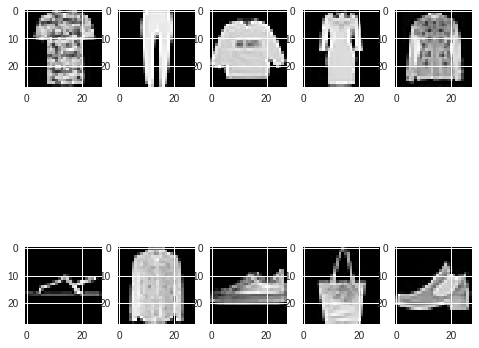

In [16]:
#@title Plot a sample image for each class.
fig = plt.figure(figsize=(8, 8))
for label in range(NUM_CLASSES):
  image = train_df[train_df['label'] == label].iloc[0, 1:]
  fig.add_subplot(2, 5, label + 1)
  plt.imshow(image.values.reshape(IMG_ROWS, IMG_COLS), cmap='gray', interpolation='none')

plt.show()

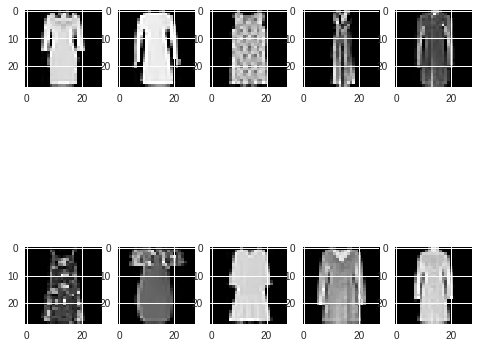

In [49]:
#@title How diverse is each class? { run: "auto" }
class_label = 29 #@param
sample_class_images = train_df[train_df['label'] == 3].head(10)
fig = plt.figure(figsize=(8, 8))
for idx in range(sample_class_images.shape[0]):
  fig.add_subplot(2, 5, idx + 1)
  image = sample_class_images.iloc[idx, 1:]
  plt.imshow(image.values.reshape(IMG_ROWS, IMG_COLS), cmap='gray', interpolation='none')

plt.show()

**Our First Model**: 

Let's build a simple Classifier for this problem. We'll use the [TF Estimator](https://www.tensorflow.org/guide/estimators) API to build our classifier as it comes with boilerplate code for training and generating metrics. Model improvements only requires you to change the model_fn().

Although our first model will be a simple [LinearClassifier](https://www.tensorflow.org/api_docs/python/tf/estimator/LinearClassifier), we'll implement the LinearClassifier as a [Custom Estimator](https://www.tensorflow.org/guide/custom_estimators) so that we can then reuse some of the code for creating a complex Estimator using Convolutional Neural networks.

Some of the boilerplate is hidden as its not important for this class. You can take a look by clicking on the cell > form > show Code.

In [0]:
#@title Boilerplate Code for feeding the dataset into the Model (Can be skipped).
def generate_input_fn(df, batch_size, num_epochs=None):
  def input_fn():
    # shuffle the rows.
    shuffle_df = df.sample(frac=1).reset_index(drop=True)
    # Separate the pixels from the labels.
    pixels = shuffle_df.iloc[:, 1:].as_matrix().astype(float)
    labels = shuffle_df.iloc[:, 0].as_matrix().astype(int)
    # Construct tf.data.DataSet from the 2 numpy arrays.
    pixels = tf.convert_to_tensor(pixels, dtype=tf.float32)
    labels = tf.convert_to_tensor(labels, dtype=tf.int32)
    dataset = tf.data.Dataset.from_tensor_slices((pixels, labels))
    dataset = dataset.shuffle(buffer_size=2 * batch_size + 1)
    dataset = dataset.batch(batch_size)
    dataset = dataset.repeat(num_epochs)
    iterator = dataset.make_one_shot_iterator()
    
    batch_pixels, batch_labels = iterator.get_next()
    
    return {"pixels": batch_pixels}, batch_labels
  
  return input_fn
  

In [0]:
#@title Linear Model (inputs -> class logits)
def linear_model_fn(features, labels, mode):
  inputs = features["pixels"]
  
  # Normalize inputs to [0, 1] range.
  normalized_inputs = inputs / MAX_PIXEL_VALUE
  
  # Linear layer directly maps to logits.
  logits = tf.layers.dense(inputs=normalized_inputs, units=NUM_CLASSES)
  predictions = {
      # Generate predictions (for PREDICT and EVAL mode)
      "classes": tf.argmax(input=logits, axis=1),
      # Add `softmax_tensor` to the graph. It is used for PREDICT and by the
      # `logging_hook`.
      "probabilities": tf.nn.softmax(logits, name="softmax_tensor")
  }

  if mode == tf.estimator.ModeKeys.PREDICT:
    return tf.estimator.EstimatorSpec(mode=mode, predictions=predictions)

  # Calculate Loss (for both TRAIN and EVAL modes)
  loss = tf.losses.sparse_softmax_cross_entropy(labels=labels, logits=logits)

  # Configure the Training Op (for TRAIN mode)
  if mode == tf.estimator.ModeKeys.TRAIN:
    optimizer = tf.train.AdamOptimizer(learning_rate=1e-4)
    train_op = optimizer.minimize(
        loss=loss,
        global_step=tf.train.get_global_step())
    return tf.estimator.EstimatorSpec(mode=mode, loss=loss, train_op=train_op)

  # Add evaluation metrics (for EVAL mode)
  eval_metric_ops = {
      "accuracy": tf.metrics.accuracy(
          labels=labels, predictions=predictions["classes"])}
  return tf.estimator.EstimatorSpec(
      mode=mode, loss=loss, eval_metric_ops=eval_metric_ops)

In [0]:
#@title Optional: Set up logging for predictions
tensors_to_log = {"probabilities": "softmax_tensor"}
logging_hook = tf.train.LoggingTensorHook(
    tensors=tensors_to_log, every_n_iter=50)

In [53]:
#@title Train the Linear Classifier.
linear_classifier = tf.estimator.Estimator(model_fn=linear_model_fn)
linear_classifier.train(input_fn=generate_input_fn(train_df, BATCH_SIZE), steps=NUM_TRAIN_STEPS, hooks=None)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': '/tmp/tmptk746bja', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x7f94f020fb70>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph wa

In [54]:
#@title Evaluate the linear Classifier on train and test set.
linear_classifier.evaluate(input_fn=generate_input_fn(train_df, BATCH_SIZE), steps=100)
linear_classifier.evaluate(input_fn=generate_input_fn(test_df, BATCH_SIZE), steps=100)

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-10-18-10:41:18
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmptk746bja/model.ckpt-4000
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Evaluation [10/100]
INFO:tensorflow:Evaluation [20/100]
INFO:tensorflow:Evaluation [30/100]
INFO:tensorflow:Evaluation [40/100]
INFO:tensorflow:Evaluation [50/100]
INFO:tensorflow:Evaluation [60/100]
INFO:tensorflow:Evaluation [70/100]
INFO:tensorflow:Evaluation [80/100]
INFO:tensorflow:Evaluation [90/100]
INFO:tensorflow:Evaluation [100/100]
INFO:tensorflow:Finished evaluation at 2018-10-18-10:41:19
INFO:tensorflow:Saving dict for global step 4000: accuracy = 0.80296874, global_step = 4000, loss = 0.58142996
INFO:tensorflow:Saving 'checkpoint_path' summary for global step 4000: /tmp/tmptk746bja/model.ckpt-4000
INFO:tensorflow:Calling model_fn.
INFO

{'accuracy': 0.81078124, 'global_step': 4000, 'loss': 0.57954884}

Ok, now that we've trained a Linear Classifier for the problem and evaluated it, it looks like the model is performing reasonably well with an accuracy of ~ 80% on the test set. Note that the accuracy on the train set is likely to be higher (and the loss lower) compared to the test set, since the model has looked at the training samples multiple times during training.

Now, there could be a tendency here to either stop (80% accuracy is good enough) or directly jump to building a more complex model. Before we build a more complex model, let's look at where the Linear Classifier gets it right and wrong.

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmptk746bja/model.ckpt-4000
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
predicted class = 4, label = 3, probs = [1.3568160e-02 2.2101606e-01 2.0824442e-02 3.4055945e-01 3.4080070e-01
 1.0479580e-05 6.1288487e-02 4.7492547e-04 9.5282674e-05 1.3620247e-03]
predicted class = 6, label = 2, probs = [1.1520707e-01 1.4736544e-03 2.2678833e-01 1.5984908e-02 1.2406196e-02
 1.4601776e-03 4.0896997e-01 1.8049729e-04 2.1735476e-01 1.7441971e-04]
predicted class = 6, label = 4, probs = [8.8838739e-03 9.9219917e-04 1.0675451e-01 1.9070175e-02 3.3694795e-01
 5.2251351e-05 5.1393956e-01 6.6411453e-06 1.3218559e-02 1.3431300e-04]
predicted class = 2, label = 6, probs = [3.4992055e-03 1.3934012e-03 3.3275753e-01 4.2673466e-03 3.2037589e-01
 4.7426196e-04 3.2523507e-01 1.4414728e-05 1.1909324e-02 7.3440591e-05]


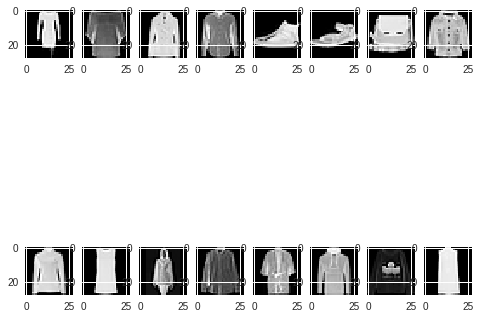

In [55]:
#@title Inspect where the Linear Classifier goes wrong.
analyse_incorrect(linear_classifier)

In [0]:
#@title Try a Convolutional Neural Network Model.
def cnn_model_fn(features, labels, mode):
  """Model function for CNN."""
  # Input Layer
  inputs = tf.reshape(features["pixels"], [-1, IMG_ROWS, IMG_COLS, 1])

  # Normalize inputs to [0, 1] range.
  normalized_inputs = inputs / MAX_PIXEL_VALUE
  
  # Convolutional Layer #1
  conv1 = tf.layers.conv2d(
      inputs=normalized_inputs,
      filters=32,
      kernel_size=[3, 3],
      padding="same",
      activation=tf.nn.relu)

  # Pooling Layer #1
  pool1 = tf.layers.max_pooling2d(inputs=conv1, pool_size=[2, 2], strides=2)

  # Convolutional Layer #2 and Pooling Layer #2
  conv2 = tf.layers.conv2d(
      inputs=pool1,
      filters=64,
      kernel_size=[3, 3],
      padding="same",
      activation=tf.nn.relu)
  pool2 = tf.layers.max_pooling2d(inputs=conv2, pool_size=[2, 2], strides=2)

  # Dense Layer
  pool2_flat = tf.reshape(pool2, [-1, 7 * 7 * 64])
  dense = tf.layers.dense(inputs=pool2_flat, units=1024, activation=tf.nn.relu)
  dropout = tf.layers.dropout(
      inputs=dense, rate=0.4, training=mode == tf.estimator.ModeKeys.TRAIN)

  # Logits Layer
  logits = tf.layers.dense(inputs=dropout, units=NUM_CLASSES)

  predictions = {
      # Generate predictions (for PREDICT and EVAL mode)
      "classes": tf.argmax(input=logits, axis=1),
      # Add `softmax_tensor` to the graph. It is used for PREDICT and by the
      # `logging_hook`.
      "probabilities": tf.nn.softmax(logits, name="softmax_tensor")
  }

  if mode == tf.estimator.ModeKeys.PREDICT:
    return tf.estimator.EstimatorSpec(mode=mode, predictions=predictions)

  # Calculate Loss (for both TRAIN and EVAL modes)
  loss = tf.losses.sparse_softmax_cross_entropy(labels=labels, logits=logits)

  # Configure the Training Op (for TRAIN mode)
  if mode == tf.estimator.ModeKeys.TRAIN:
    optimizer = tf.train.AdamOptimizer(learning_rate=1e-4)
    train_op = optimizer.minimize(
        loss=loss,
        global_step=tf.train.get_global_step())
    return tf.estimator.EstimatorSpec(mode=mode, loss=loss, train_op=train_op)

  # Add evaluation metrics (for EVAL mode)
  eval_metric_ops = {
      "accuracy": tf.metrics.accuracy(
          labels=labels, predictions=predictions["classes"])}
  return tf.estimator.EstimatorSpec(
      mode=mode, loss=loss, eval_metric_ops=eval_metric_ops)

In [57]:
#@title Train the CNN Classifier model.
cnn_classifier = tf.estimator.Estimator(model_fn=cnn_model_fn)
cnn_classifier.train(input_fn=generate_input_fn(train_df, BATCH_SIZE), steps=NUM_TRAIN_STEPS, hooks=None)

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_model_dir': '/tmp/tmpgjwzjdk1', '_tf_random_seed': None, '_save_summary_steps': 100, '_save_checkpoints_steps': None, '_save_checkpoints_secs': 600, '_session_config': allow_soft_placement: true
graph_options {
  rewrite_options {
    meta_optimizer_iterations: ONE
  }
}
, '_keep_checkpoint_max': 5, '_keep_checkpoint_every_n_hours': 10000, '_log_step_count_steps': 100, '_train_distribute': None, '_device_fn': None, '_protocol': None, '_eval_distribute': None, '_experimental_distribute': None, '_service': None, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x7f94f015d438>, '_task_type': 'worker', '_task_id': 0, '_global_id_in_cluster': 0, '_master': '', '_evaluation_master': '', '_is_chief': True, '_num_ps_replicas': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph wa

In [58]:
#@title Evaluate the CNN Classifier on train and test set.
cnn_classifier.evaluate(input_fn=generate_input_fn(train_df, BATCH_SIZE), steps=100)
cnn_classifier.evaluate(input_fn=generate_input_fn(test_df, BATCH_SIZE), steps=100)

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-10-18-10:58:41
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmpgjwzjdk1/model.ckpt-4000
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Evaluation [10/100]
INFO:tensorflow:Evaluation [20/100]
INFO:tensorflow:Evaluation [30/100]
INFO:tensorflow:Evaluation [40/100]
INFO:tensorflow:Evaluation [50/100]
INFO:tensorflow:Evaluation [60/100]
INFO:tensorflow:Evaluation [70/100]
INFO:tensorflow:Evaluation [80/100]
INFO:tensorflow:Evaluation [90/100]
INFO:tensorflow:Evaluation [100/100]
INFO:tensorflow:Finished evaluation at 2018-10-18-10:58:45
INFO:tensorflow:Saving dict for global step 4000: accuracy = 0.8915625, global_step = 4000, loss = 0.2909946
INFO:tensorflow:Saving 'checkpoint_path' summary for global step 4000: /tmp/tmpgjwzjdk1/model.ckpt-4000
INFO:tensorflow:Calling model_fn.
INFO:t

{'accuracy': 0.8960937, 'global_step': 4000, 'loss': 0.28676865}

INFO:tensorflow:Calling model_fn.
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /tmp/tmpgjwzjdk1/model.ckpt-4000
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
predicted class = 6, label = 2, probs = [1.4026923e-02 8.2126440e-05 4.3797347e-01 1.2069577e-03 9.2905834e-03
 9.6876625e-05 5.3716671e-01 1.5680176e-05 1.1816230e-04 2.2529079e-05]
predicted class = 6, label = 2, probs = [4.1316204e-02 2.5432286e-04 1.3543622e-01 1.5924677e-03 3.6896740e-03
 4.7435528e-06 8.1556934e-01 8.7586380e-07 2.1359154e-03 2.1687960e-07]
predicted class = 6, label = 2, probs = [9.7003154e-02 1.5897224e-04 1.5725303e-01 6.5482939e-03 2.0388071e-03
 5.2762614e-04 7.2782803e-01 1.5436579e-04 8.3595868e-03 1.2820741e-04]
predicted class = 7, label = 5, probs = [2.5277329e-04 2.7871006e-06 1.6058514e-04 9.4636067e-05 3.1893942e-05
 2.8554067e-01 7.1026509e-05 6.9872695e-01 5.7719700e-04 1.4541521e-02]


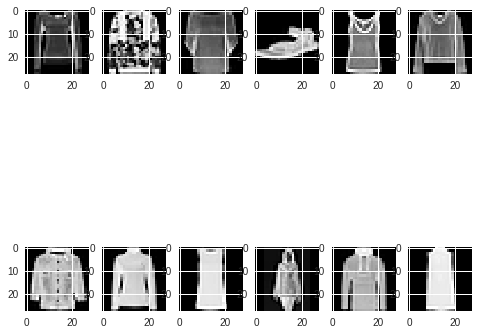

In [59]:
analyse_incorrect(cnn_classifier)